In [1]:
import numpy as np
import re
import pandas as pd
import skfuzzy as fuzz
import matplotlib.pyplot as plt
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import time

In [2]:
start = time.time()

In [2]:
traindatadf=pd.read_fwf(r'sentiment labelled sentences/imdb_labelled.txt')  

traindatadf.to_csv('imdb_labelled.csv')

In [3]:
traindata=pd.read_csv('imdb_labelled.csv',header=None)
# traindata.head()
print(type(traindata))



<class 'pandas.core.frame.DataFrame'>


In [4]:
traindata=traindata.drop(columns=[0],axis=1)
traindata.head()
print(type(traindata))

<class 'pandas.core.frame.DataFrame'>


In [5]:
traindata.rename(columns={1:'text'},inplace=True)


In [6]:
traindata.head()

,text
0,So there is no way for me to plug it in here i...
1,"Good case, Excellent value.\t1"
2,Great for the jawbone.\t1
3,Tied to charger for conversations lasting more...
4,The mic is great.\t1


In [7]:
traindata.to_csv('imdb_labelled.csv',index=False)

In [8]:
traindatadf=pd.read_csv('imdb_labelled.csv')
traindatadf.head()
print(len(traindatadf))

1000


In [9]:
traindatadf[['full_text','sentiment']]=traindatadf.text.str.split("\t",expand=True) 
    

In [10]:
traindatadf=traindatadf.drop(columns=['text'],axis=1)

In [11]:
traindatadf.to_csv('imdb_labelled.csv',index=False)

In [2]:
traindatadf=pd.read_csv('imdb_labelled.csv')
traindatadf.head()
# print(len(traindatadf))

,full_text,sentiment
0,"A very, very, very slow-moving, aimless movie ...",0
1,Not sure who was more lost - the flat characte...,0
2,Attempting artiness with black & white and cle...,0
3,Very little music or anything to speak of.,0
4,The best scene in the movie was when Gerardo i...,1


In [3]:
traindata2=pd.read_csv("imdb_labelled.csv")  
doc=traindata2.full_text
print(len(doc))
sentidoc=traindata2.sentiment


948


In [2]:
# Generate universe variables
#   * pos and neg on subjective ranges [0, 1]
#   * op has a range of [0, 10] in units of percentage points
x_p = np.arange(0, 1, 0.1)
x_n = np.arange(0, 1, 0.1)
x_op = np.arange(0, 10, 1)

In [3]:
x_op

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])

In [4]:
# Generate fuzzy membership functions
p_lo = fuzz.trimf(x_p, [0, 0, 0.5])
p_md = fuzz.trimf(x_p, [0, 0.5, 1])
p_hi = fuzz.trimf(x_p, [0.5, 1, 1])
n_lo = fuzz.trimf(x_n, [0, 0, 0.5])
n_md = fuzz.trimf(x_n, [0, 0.5, 1])
n_hi = fuzz.trimf(x_n, [0.5, 1, 1])
op_Neg = fuzz.trimf(x_op, [0, 0, 5])  # Scale : Neg Neu Pos
op_Neu = fuzz.trimf(x_op, [0, 5, 10])
op_Pos = fuzz.trimf(x_op, [5, 10, 10])


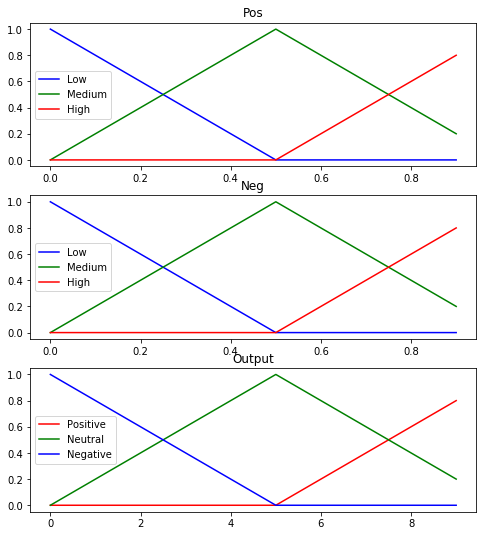

In [6]:
# Visualize these universes and membership functions
fig, (ax0, ax1, ax2) = plt.subplots(nrows=3, figsize=(8, 9))
#
ax0.plot(x_p, p_lo, 'b', linewidth=1.5, label='Low')
ax0.plot(x_p, p_md, 'g', linewidth=1.5, label='Medium')
ax0.plot(x_p, p_hi, 'r', linewidth=1.5, label='High')
ax0.set_title('Pos')
ax0.legend()

ax1.plot(x_n, n_lo, 'b', linewidth=1.5, label='Low')
ax1.plot(x_n, n_md, 'g', linewidth=1.5, label='Medium')
ax1.plot(x_n, n_hi, 'r', linewidth=1.5, label='High')
ax1.set_title('Neg')
ax1.legend()

ax2.plot(x_op, op_Pos, 'r', linewidth=1.5, label='Positive')
ax2.plot(x_op, op_Neu, 'g', linewidth=1.5, label='Neutral')
ax2.plot(x_op, op_Neg, 'b', linewidth=1.5, label='Negative')
ax2.set_title('Output')
ax2.legend()


In [6]:
tweets=[]
senti=[]
sentiment=[]
sentiment_doc=[]

for j in range(len(doc)):
    str1=traindata2.full_text[j]
    str2=str1.lower()
    tweets.append(str2)   # converted into lower case
    senti.append(traindata2.sentiment[j])

In [28]:
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\lapi\AppData\Roaming\nltk_data...


True

In [7]:
def decontracted(phrase):   # text pre-processing 
        # specific
        phrase = re.sub(r"won't", "will not", phrase)
        phrase = re.sub(r"can\'t", "can not", phrase)
        phrase = re.sub(r"@", "" , phrase)         # removal of @
        phrase =  re.sub(r"http\S+", "", phrase)   # removal of URLs
        phrase = re.sub(r"#", "", phrase)          # hashtag processing
    
        # general
        phrase = re.sub(r"n\'t", " not", phrase)
        phrase = re.sub(r"\'re", " are", phrase)
        phrase = re.sub(r"\'s", " is", phrase)
        phrase = re.sub(r"\'d", " would", phrase)
        phrase = re.sub(r"\'ll", " will", phrase)
        phrase = re.sub(r"\'t", " not", phrase)
        phrase = re.sub(r"\'ve", " have", phrase)
        phrase = re.sub(r"\'m", " am", phrase)
        return phrase
    

In [8]:
for k in range(len(doc)):
    tweets[k]=decontracted(tweets[k])
         
sid = SentimentIntensityAnalyzer()


In [12]:
print(senti[7])

doclen=len(doc)
doclen

1


948

1 a very, very, very slow-moving, aimless movie about a distressed, drifting young man.   {'neg': 0.219, 'neu': 0.781, 'pos': 0.0, 'compound': -0.4215}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Negative
Doc sentiment: 0

2 not sure who was more lost - the flat characters or the audience, nearly half of whom walked out.   {'neg': 0.222, 'neu': 0.778, 'pos': 0.0, 'compound': -0.5507}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neut


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: 1

15 this is a very "right on case" movie that delivers everything almost right in your face.   {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggre

C:\Users\lapi\Anaconda3\lib\site-packages\ipykernel_launcher.py:78: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 1

24 it is quite simply the highest, most superlative form of cinema imaginable.   {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output:


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 1

38 buy it, play it, enjoy it, love it.  ---------------------------- {'neg': 0.0, 'neu': 0.338, 'pos': 0.662, 'compound': 0.8689}

Positive Score for each  tweet :
0.7

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0. 

op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Positive
Doc sentiment: 1

51 in addition to having one of the most lovely songs ever written, french cancan also boasts one of the cutest leading ladies ever to grace the screen.   {'neg': 0.0, 'neu': 0.692, 'pos': 0.308, 'compound': 0.8932}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Positive
Doc sentiment: 1

52 it is hard not to fall head-o


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: 0

65 one character is totally annoying with a voice that gives me the feeling of fingernails on a chalkboard.   {'neg': 0.162, 'neu': 0.757, 'pos': 0.081, 'compound': -0.3597}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activatio


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: 1

78 he is an amazing film artist, one of the most important whoever lived.   {'neg': 0.0, 'neu': 0.651, 'pos': 0.349, 'compound': 0.7089}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggreg


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

92 the only suspense i was feeling was the frustration at just how retarded the girls were.   {'neg': 0.335, 'neu': 0.591, 'pos': 0.074, 'compound': -0.743}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.


Output after Defuzzification: Negative
Doc sentiment: 0

106 an hour and a half i wish i could bring back.  ------------------ {'neg': 0.0, 'neu': 0.722, 'pos': 0.278, 'compound': 0.4019}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Positive
Doc sentiment: 0

107 but in terms of the writing it is very fresh and bold.  --------- {'neg': 0.0, 'neu': 0.582, 'pos': 0.418, 'compound': 0.8012}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of 

0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 1

122 brilliant!  ----------------------------------------------------- {'neg': 0.0, 'neu': 0.0, 'pos': 1.0, 'compound': 0.6239}

Positive Score for each  tweet :
0.9

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Negative
Doc sentiment: 0

135 i saw "mirrormask" last night and it was an unsatisfactory experience.   {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated O


Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]

Defuzzified Output: 1.67

Output after Defuzzification: Negative
Doc sentiment: 0

150 no plot whatsoever!  -------------------------------------------- {'neg': 0.555, 'neu': 0.445, 'pos': 0.0, 'compound': -0.3595}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.6

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0


Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]

Defuzzified Output: 1.67

Output after Defuzzification: Negative
Doc sentiment: 0

164 still, i do like this movie for it is empowerment of women; there is not enough movies out there like this one.   {'neg': 0.0, 'neu': 0.792, 'pos': 0.208, 'compound': 0.6124}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.

Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]

Defuzzified Output: 1.67

Output after Defuzzification: Negative
Doc sentiment: 0

176 the lead man is charisma-free.  --------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Positive
Doc sentiment: 1

188 this movie suffered because of the writing, it needed more suspense.   {'neg': 0.242, 'neu': 0.758, 'pos': 0.0, 'compound': -0.4939}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

204 another thing i did not really like is when a character got punched in the face, a gallon of blood would spew forth soon after.   {'neg': 0.1, 'neu': 0.9, 'pos': 0.0, 'compound': -0.3241}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 

0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

219 this is a chilly, unremarkable movie about an author living/working in a chilly abstruse culture.   {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0.


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]

Defuzzified Output: 1.72

Output after Defuzzification: Negative
Doc sentiment: 0

233 you can not even tell if they have any talent because they not only have pathetic lines to speak but the director gave them no action.   {'neg': 0.094, 'neu': 0.774, 'pos': 0.131, 'compound': 0.0256}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

245 the soundtrack sucked.  ----------------------------------------- {'neg': 0.6, 'neu': 0.4, 'pos': 0.0, 'compound': -0.4588}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.6

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.2 0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.88

Output after Defuzzification: Positive
Doc sentiment: 1

261 it ranks highly as a great noir-crime-drama, incredible performances by belmondo and lino ventura.   {'neg': 0.0, 'neu': 0.733, 'pos': 0.267, 'compound': 0.6573}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: 

275 and do not even get me started on the jerky camerawork.  -------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

276 when i saw it in the theater i thought i was going to be sick.  - {'neg': 0.231, 'neu': 0.769, 'pos': 0.0, 'compound': -0.5106}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant con


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Positive
Doc sentiment: 1

291 i recommend this for everyone who loves film, movies, anything...a work of art!   {'neg': 0.0, 'neu': 0.606, 'pos': 0.394, 'compound': 0.7574}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Positive
Doc sentiment: 1

306 the telephone repair man was really funny and his reactions to the nuts and bitchy boss were truly genuine.   {'neg': 0.21, 'neu': 0.562, 'pos': 0.228, 'compound': 0.1263}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activat


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Negative
Doc sentiment: 0

322 started watching this but did not believe in any of the characters.   {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Outp


Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]

Defuzzified Output: 1.67

Output after Defuzzification: Negative
Doc sentiment: 0

338 the guy who said he is had better dialogue with his potted plants has it right.   {'neg': 0.0, 'neu': 0.838, 'pos': 0.162, 'compound': 0.4404}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.

Output after Defuzzification: Positive
Doc sentiment: 1

353 damian is so talented and versatile in so many ways of writing and portraying different characters on screen.   {'neg': 0.0, 'neu': 0.8, 'pos': 0.2, 'compound': 0.6418}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Positive
Doc sentiment: 1

354 this movie has a cutting edge to it.  --------------------------- {'neg': 0.2, 'neu': 0.8, 'pos': 0.0, 'compound': -0.128}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Neg


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Negative
Doc sentiment: 0

369 god, and i can never get that 90 minutes back!  ----------------- {'neg': 0.0, 'neu': 0.77, 'pos': 0.23, 'compound': 0.3382}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggr


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Positive
Doc sentiment: 1

384 the good cinematography also makes her and monica bellucci look very beautiful.   {'neg': 0.0, 'neu': 0.585, 'pos': 0.415, 'compound': 0.796}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: 1

397 not too screamy not to masculine but just right.  --------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.4]

Defuzzified Output: 4.11

Output after Defuzzification: Negative
Doc sentiment: 0

411 i am not a filmmaker nor am i a director but i would hide my head in the sand if i would spent whatever amount of money and time on this movie.   {'neg': 0.076, 'neu': 0.924, 'pos': 0.0, 'compound': -0.2617}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Negative
Doc sentiment: 0

423 i like armand assante & my cable company is summary sounded interesting, so i watched it, twice already, and probably will again.   {'neg': 0.0, 'neu': 0.766, 'pos': 0.234, 'compound': 0.6369}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]


Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Negative
Doc sentiment: 0

437 i know he was a contract player with little control over his scripts, but the acting was as bad as the script.   {'neg': 0.2, 'neu': 0.8, 'pos': 0.0, 'compound': -0.6956}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Outp

0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: 0

453 hackneyed writing, certainly, but made even worse by the bad directing.   {'neg': 0.478, 'neu': 0.43, 'pos': 0.091, 'compound': -0.8481}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.5

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Positive
Doc sentiment: 1

467 but this movie really got to me.  ------------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: 

op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Negative
Doc sentiment: 0

482 by the time the film ended, i not only disliked it, i despised it.   {'neg': 0.181, 'neu': 0.669, 'pos': 0.151, 'compound': -0.1134}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Positive
Doc sentiment: 0

483 what this film lacks is a convincing script.  ------------------- {'neg': 0.0, 'neu': 0.69, 'pos': 0.31, 'c


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Positive
Doc sentiment: 0

497 rating: 0/10 (grade: z) note: the show is so bad that even mother of the cast pull her daughter out of the show.   {'neg': 0.17, 'neu': 0.83, 'pos': 0.0, 'compound': -0.6696}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_acti


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Negative
Doc sentiment: 0

512 there is no real plot.  ----------------------------------------- {'neg': 0.355, 'neu': 0.645, 'pos': 0.0, 'compound': -0.296}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.4

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Ag

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

525 this may be the only bad film he ever made.  -------------------- {'neg': 0.28, 'neu': 0.72, 'pos': 0.0, 'compound': -0.5423}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Negative
Doc sentiment: 0

526 so bad...well...it is just bad.  -------------------------------- {'neg': 0.467, 'neu': 0.533, 'pos': 0.0, 'compound': -0.5423}

Positive Score for each  tweet :
0.0

Negative S

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

538 one of the most disappointing aspects is the lack of notable gore.   {'neg': 0.367, 'neu': 0.633, 'pos': 0.0, 'compound': -0.6997}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.4

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Positive
Doc sentiment: 1

551 with the originality and freshness of the first movie now spent, this remake had little else to offer.   {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0.


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Positive
Doc sentiment: 1

566 but "tiny toons" kept the 90 is vibe and delivered one of the most popular, funny, and underrated cartoons ever created.   {'neg': 0.0, 'neu': 0.623, 'pos': 0.377, 'compound': 0.8981}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activ


Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]

Defuzzified Output: 1.67

Output after Defuzzification: Negative
Doc sentiment: 0

581 and the accents are absolutely abysmal!  ------------------------ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Negative
Doc sentiment: 0

596 avoid at all costs.  -------------------------------------------- {'neg': 0.423, 'neu': 0.577, 'pos': 0.0, 'compound': -0.296}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.4

Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Ag


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: 1

609 but it is entertaining, nonetheless.  --------------------------- {'neg': 0.0, 'neu': 0.51, 'pos': 0.49, 'compound': 0.5927}

Positive Score for each  tweet :
0.5

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 1.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Positive
Doc sentiment: 1

621 do not be afraid of subtitles........ its worth a little aversion therapy 10/10   {'neg': 0.18, 'neu': 0.689, 'pos': 0.131, 'compound': -0.1796}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

636 then the film just dropped the ball.  --------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.

662 it is a mediocre, miserable, hollow, laughable and predictable piece of garbage.   {'neg': 0.239, 'neu': 0.672, 'pos': 0.09, 'compound': -0.4588}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Negative
Doc sentiment: 0

663 it is a case of  iso bad it is laughable'.  --------------------- {'neg': 0.304, 'neu': 0.696, 'pos': 0.0, 'compound': -0.5423}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing S

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Positive
Doc sentiment: 0

676 lame would be the best way to describe it.  --------------------- {'neg': 0.2, 'neu': 0.5, 'pos': 0.3, 'compound': 0.34}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]

Defuzzified Output: 4.52

Output after Defuzzification: Negative
Doc sentiment: 0

689 seriously, it is not worth wasting your, or your kid is time on.   {'neg': 0.215, 'neu': 0.64, 'pos': 0.145, 'compound': -0.0279}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

705 i just saw this film and i recommend it.  ----------------------- {'neg': 0.0, 'neu': 0.706, 'pos': 0.294, 'compound': 0.3612}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated O

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.4 0.6 0.8]

Defuzzified Output: 5.87

Output after Defuzzification: Positive
Doc sentiment: 1

717 a very charming film with wonderful sentiment and heart.  ------- {'neg': 0.0, 'neu': 0.435, 'pos': 0.565, 'compound': 0.8313}

Positive Score for each  tweet :
0.6

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Ou

op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: 0

730 i am so tired of clichã©s that is just lazy writing, and here they come in thick and fast.   {'neg': 0.262, 'neu': 0.738, 'pos': 0.0, 'compound': -0.6901}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Negative
Doc sentiment: 0

731 ps the only scene in the movie tha


Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: 1

746 i loved it, it was really scary.  ------------------------------- {'neg': 0.307, 'neu': 0.351, 'pos': 0.342, 'compound': 0.1045}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Po


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Positive
Doc sentiment: 1

759 it is wonderful and inspiring to watch, and i hope that it gets released again on to video or dvd.   {'neg': 0.0, 'neu': 0.63, 'pos': 0.37, 'compound': 0.8555}

Positive Score for each  tweet :
0.4

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0.  0.  0. 


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.98

Output after Defuzzification: Positive
Doc sentiment: 1

772 but this understated film leaves a lasting impression.  --------- {'neg': 0.0, 'neu': 0.719, 'pos': 0.281, 'compound': 0.3291}

Positive Score for each  tweet :
0.3

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Ag


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: 1

785 see it with your kids if you have a chance--it will open up some amazing dialog about how far race relations have come in the last 50 years.   {'neg': 0.0, 'neu': 0.872, 'pos': 0.128, 'compound': 0.5859}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2


Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.6 0.6 0.6 0.4 0.4 0.4 0.4 0.4 0.4 0.2]

Defuzzified Output: 3.99

Output after Defuzzification: Negative
Doc sentiment: 0

797 this movie is possibly one of the most creative works of horror ever.   {'neg': 0.207, 'neu': 0.615, 'pos': 0.178, 'compound': -0.1298}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0


Firing Strength of Negative (wneg): 0.8
Firing Strength of Neutral (wneu): 0.2
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.8 0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.8 0.8 0.6 0.4 0.2 0.2 0.2 0.2 0.2 0.2]

Defuzzified Output: 3.09

Output after Defuzzification: Negative
Doc sentiment: 0

810 in short, do not bother with this movie.  ----------------------- {'neg': 0.0, 'neu': 0.775, 'pos': 0.225, 'compound': 0.2584}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Ag


Firing Strength of Negative (wneg): 1.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [1.  0.8 0.6 0.4 0.2 0.  0.  0.  0.  0. ]

Defuzzified Output: 1.67

Output after Defuzzification: Negative
Doc sentiment: 0

822 the script is horrendously stupid.  ----------------------------- {'neg': 0.677, 'neu': 0.323, 'pos': 0.0, 'compound': -0.743}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.7

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

837 avoid at any and all costs.  ------------------------------------ {'neg': 0.306, 'neu': 0.694, 'pos': 0.0, 'compound': -0.296}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.3

Firing Strength of Negative (wneg): 0.6
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0.6 0.6 0.6 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated O


Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Positive
Doc sentiment: 1

851 otherwise, do not even waste your time on this.  ---------------- {'neg': 0.0, 'neu': 0.774, 'pos': 0.226, 'compound': 0.3252}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzification: Positive
Doc sentiment: 0

863 the acting is like watching wooden puppets moving around and reading from a book, that is how bad it is.   {'neg': 0.152, 'neu': 0.739, 'pos': 0.109, 'compound': -0.25}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.0
Firing Strength of Positive (wpos): 0.8

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.8]

Defuzzified Output: 7.67

Output after Defuzzification: Positive
Doc sentiment: 1

878 it was a long time that i did not see a so charismatic actor on screen.   {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Positive
Doc sentiment: 1

890 the story is also both funny and poignant at times.  ------------ {'neg': 0.0, 'neu': 0.756, 'pos': 0.244, 'compound': 0.4404}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Ag


Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.8
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.2 0.2 0.2]

Aggregated Output: [0.2 0.2 0.4 0.6 0.8 0.8 0.8 0.6 0.4 0.2]

Defuzzified Output: 4.81

Output after Defuzzification: Positive
Doc sentiment: 0

904 it is too bad that everyone else involved did not share crowe is level of dedication to quality, for if they did, we would have a far better film on our hands than this sub-par mess.   {'neg': 0.189, 'neu': 0.742, 'pos': 0.069, 'compound': -0.6108}

Positive Score for each  tweet :
0.1

Negative Score for each  tweet :
0.2

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.2

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0

Firing Strength of Negative (wneg): 0.4
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.4 0.4 0.4 0.4 0.2 0.  0.  0.  0.  0. ]
op_activation_med: [0.  0.2 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.4 0.4]

Aggregated Output: [0.4 0.4 0.4 0.6 0.6 0.6 0.6 0.6 0.4 0.4]

Defuzzified Output: 4.61

Output after Defuzzification: Positive
Doc sentiment: 1

918 hayao miyazaki is latest and eighth film for studio ghibili, "gake no ue no ponyo" (ponyo on the cliff by the sea) is a wonderfully fun and imaginative look at childhood.   {'neg': 0.117, 'neu': 0.691, 'pos': 0.191, 'compound': 0.5859}

Positive Score for each  tweet :
0.2

Negative Score for each  tweet :
0.1

Firing Strength of Negative (wneg): 0.2
Firing Strength of Neutral (wneu): 0.6
Firing Strength of Positive (wpos): 0.4

Resultant consequents MFs:
op_activation_low: [0.2 0.2 0.2 0.2 0.2 0.  0.  0.  0.  0. 


Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 0.4
Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.4 0.2]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.2 0.4 0.4 0.4 0.4 0.4 0.4 0.6 0.6]

Defuzzified Output: 5.26

Output after Defuzzification: Positive
Doc sentiment: 1

930 i keep watching it over and over.  ------------------------------ {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: 

Firing Strength of Positive (wpos): 0.6

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_high: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Aggregated Output: [0.  0.  0.  0.  0.  0.  0.2 0.4 0.6 0.6]

Defuzzified Output: 7.6

Output after Defuzzification: Positive
Doc sentiment: 1

943 i never walked out of a movie faster.  -------------------------- {'neg': 0.0, 'neu': 1.0, 'pos': 0.0, 'compound': 0.0}

Positive Score for each  tweet :
0.0

Negative Score for each  tweet :
0.0

Firing Strength of Negative (wneg): 0.0
Firing Strength of Neutral (wneu): 1.0
Firing Strength of Positive (wpos): 0.0

Resultant consequents MFs:
op_activation_low: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
op_activation_med: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]
op_activation_high: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]

Aggregated Output: [0.  0.2 0.4 0.6 0.8 1.  0.8 0.6 0.4 0.2]

Defuzzified Output: 4.91

Output after Defuzzifi

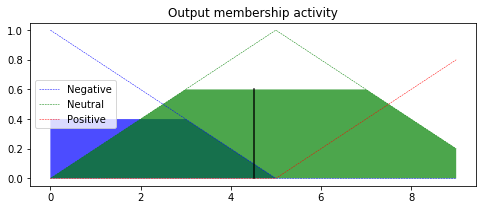

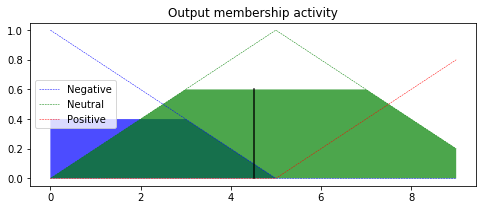

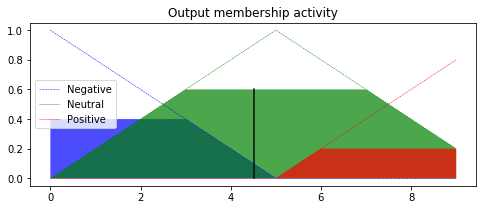

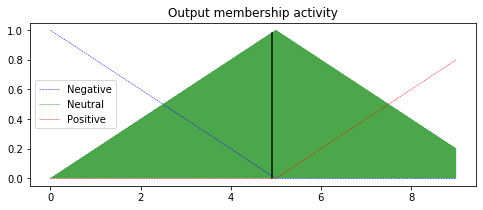

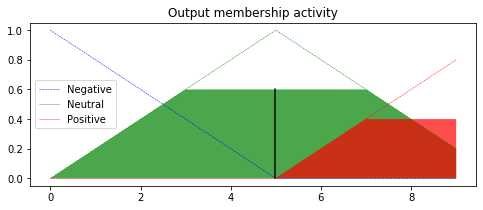

...

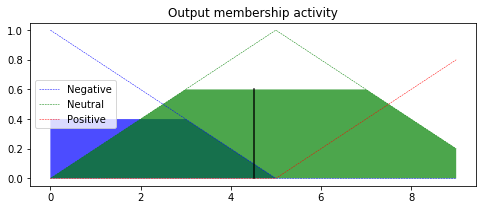

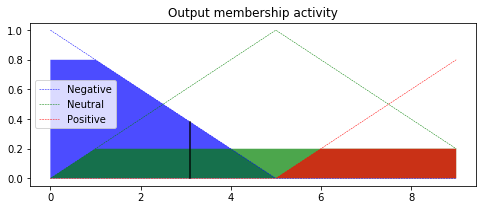

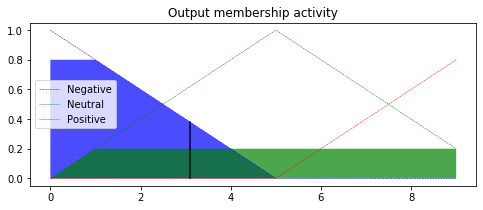

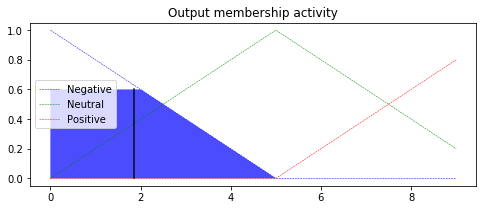

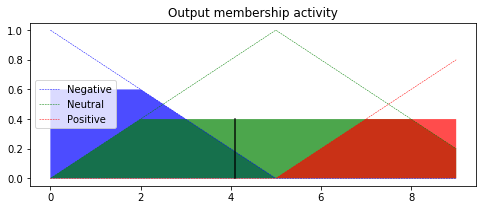

In [43]:
sentiment_val=[]
sentiment_doc=[]
for j in range(doclen):
    sentiment_doc.append(senti[j])
    ss = sid.polarity_scores(tweets[j])
    posscore=ss['pos']
    negscore=ss['neg']
    neuscore=ss['neu']
    compoundscore=ss['compound']
   
    print(str(j+1)+" {:-<65} {}".format(tweets[j], str(ss))) 
    
    print("\nPositive Score for each  tweet :")    
    if (posscore==1):
        posscore=0.9 
    else:
        posscore=round(posscore,1)
    print(posscore)

    print("\nNegative Score for each  tweet :")
    if (negscore==1):
        negscore=0.9
    else:
        negscore=round(negscore,1)
    print(negscore)

# We need the activation of our fuzzy membership functions at these values.
    p_level_lo = fuzz.interp_membership(x_p, p_lo, posscore)
    p_level_md = fuzz.interp_membership(x_p, p_md, posscore)
    p_level_hi = fuzz.interp_membership(x_p, p_hi, posscore)
    
    n_level_lo = fuzz.interp_membership(x_n, n_lo, negscore)
    n_level_md = fuzz.interp_membership(x_n, n_md, negscore)
    n_level_hi = fuzz.interp_membership(x_n, n_hi, negscore)
    
    # Now we take our rules and apply them. Rule 1 concerns bad food OR nice.
    # The OR operator means we take the maximum of these two.
    active_rule1 = np.fmin(p_level_lo, n_level_lo)
    active_rule2 = np.fmin(p_level_md, n_level_lo)
    active_rule3 = np.fmin(p_level_hi, n_level_lo)
    active_rule4 = np.fmin(p_level_lo, n_level_md)
    active_rule5 = np.fmin(p_level_md, n_level_md)
    active_rule6 = np.fmin(p_level_hi, n_level_md)
    active_rule7 = np.fmin(p_level_lo, n_level_hi)
    active_rule8 = np.fmin(p_level_md, n_level_hi)
    active_rule9 = np.fmin(p_level_hi, n_level_hi)
    
    # Now we apply this by clipping the top off the corresponding output
    # membership function with `np.fmin`
    
    n1=np.fmax(active_rule4,active_rule7)
    n2=np.fmax(n1,active_rule8)     
    op_activation_lo = np.fmin(n2,op_Neg)
    
    neu1=np.fmax(active_rule1,active_rule5)
    neu2=np.fmax(neu1,active_rule9)     
    op_activation_md = np.fmin(neu2,op_Neu)
    
    p1=np.fmax(active_rule2,active_rule3)
    p2=np.fmax(p1,active_rule6)   
    op_activation_hi = np.fmin(p2,op_Pos)
    
    op0 = np.zeros_like(x_op)
    
    # Aggregate all three output membership functions together
    aggregated = np.fmax(op_activation_lo,
                         np.fmax(op_activation_md, op_activation_hi))
    
    # Calculate defuzzified result
    op = fuzz.defuzz(x_op, aggregated, 'centroid')
    output=round(op,2)

    op_activation = fuzz.interp_membership(x_op, aggregated, op)  # for plot


    
    # Visualize Output Membership
    fig, ax0 = plt.subplots(figsize=(8, 3))
    
    ax0.fill_between(x_op, op0, op_activation_lo, facecolor='b', alpha=0.7)
    ax0.plot(x_op, op_Neg, 'b', linewidth=0.5, linestyle='--',label= 'Negative' )
    ax0.fill_between(x_op, op0, op_activation_md, facecolor='g', alpha=0.7)
    ax0.plot(x_op, op_Neu, 'g', linewidth=0.5, linestyle='--', label='Neutral')
    ax0.fill_between(x_op, op0, op_activation_hi, facecolor='r', alpha=0.7)
    ax0.plot(x_op, op_Pos, 'r', linewidth=0.5, linestyle='--', label='Positive')
    ax0.plot([op, op], [0, op_activation], 'k', linewidth=1.5, alpha=0.9)
    ax0.set_title('Output membership activity')
    ax0.legend()

    print("\nFiring Strength of Negative (wneg): "+str(round(n2,4)))
    print("Firing Strength of Neutral (wneu): "+str(round(neu2,4)))
    print("Firing Strength of Positive (wpos): "+str(round(p2,4)))
    
    print("\nResultant consequents MFs:" )
    print("op_activation_low: "+str(op_activation_lo))
    print("op_activation_med: "+str(op_activation_md))
    print("op_activation_high: "+str(op_activation_hi))
    
    print("\nAggregated Output: "+str(aggregated))

    print("\nDefuzzified Output: "+str(output))

# Scale : Neg Neu Pos   
#     if 0<(output)<3.33:    # R
#         print("\nOutput after Defuzzification: Negative")
#         sentiment.append("Negative")
#         sentiment_val.append('0')
#     elif 3.34<(output)<6.66:
#         print("\nOutput after Defuzzification: Neutral")
#         sentiment.append("Neutral")
#         sentiment_val.append('2')
   
#     elif 6.67<(output)<10:
#         print("\nOutput after Defuzzification: Positive")
#         sentiment.append("Positive")
#         sentiment_val.append('1')

    if 0<(output)<4.55:    # R
        print("\nOutput after Defuzzification: Negative")
        sentiment.append("Negative")
        sentiment_val.append('0')
   
    elif 4.56<(output)<10:
        print("\nOutput after Defuzzification: Positive")
        sentiment.append("Positive")
        sentiment_val.append('1')
        
        
        
    print("Doc sentiment: " +str(senti[j])+"\n")    
    
# count=0
# for k in range(len(doc)):
#     if(sentiment_doc[k]==sentiment[k]):
#         count=count+1       
# print("Accuracy is: "+ str(round(count/len(doc)*100,2)))

# from sklearn.metrics import f1_score, precision_score, recall_score
# y_true = sentiment_doc
# y_pred = sentiment

# p1=precision_score(y_true, y_pred, average='macro')  

# print("Precision score (MACRO): " + str(round((p1*100),2)))

# r1=recall_score(y_true, y_pred, average='macro')  

# print("Recall score (MACRO): " + str(round((r1*100),2)))

# f1=f1_score(y_true, y_pred, average='macro')  
# f2=f1_score(y_true, y_pred, average='micro')  

# print("F1 score (MACRO): " + str(round((f1*100),2)))
# print("F1 score (MICRO): "+ str(round((f2*100),2)))

# end = time.time()
# print("Execution Time: "+str(round((end - start),3))+" secs")

In [44]:
sentiment_val = [int(i) for i in sentiment_val]
print(len(sentiment_val))

948


In [45]:
print(sentiment_doc[0]==sentiment_val[0])
print(type(sentiment_val[0]))

True
<class 'int'>


In [46]:
count=0
for k in range(doclen):
    if(sentiment_doc[k]==sentiment_val[k]):
        count=count+1       
print("Accuracy is: "+ str(round(count/doclen*100,2)))

from sklearn.metrics import f1_score, precision_score, recall_score
y_true = sentiment_doc[:]
y_pred = sentiment_val

print(len(y_true))
p1=precision_score(y_true, y_pred, average='macro')  

print("Precision score (MACRO): " + str(round((p1*100),2)))

r1=recall_score(y_true, y_pred, average='macro')  

print("Recall score (MACRO): " + str(round((r1*100),2)))

f1=f1_score(y_true, y_pred, average='macro')  
f2=f1_score(y_true, y_pred, average='micro')  

print("F1 score (MACRO): " + str(round((f1*100),2)))
print("F1 score (MICRO): "+ str(round((f2*100),2)))

# # end = time.time()
# print("Execution Time: "+str(round((end - start),3))+" secs")

Accuracy is: 73.84
948
Precision score (MACRO): 79.62
Recall score (MACRO): 74.02
F1 score (MACRO): 72.6
F1 score (MICRO): 73.84
